# EYE FOR BLIND
This notebook will be used to prepare the capstone project 'Eye for Blind'

Installing google text to speech API (gTTS) as we would be using this to convert captions to speech, and

Installing playsound to play the speech on notebook

In [1]:
pip install gTTS 

Note: you may need to restart the kernel to use updated packages.


In [2]:
pip install playsound 

Note: you may need to restart the kernel to use updated packages.


In [3]:
#Import all the required libraries
import os
import glob
import time

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

import collections
from operator import itemgetter
from keras.preprocessing.text import Tokenizer
import json

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers,Model
from keras.applications.inception_v3 import InceptionV3
from keras.applications.inception_v3 import preprocess_input
from tqdm import tqdm

from sklearn.model_selection import train_test_split

import cv2
from skimage import io
from PIL import Image

from gtts import gTTS
from playsound import playsound
from IPython import display

import warnings
warnings.filterwarnings('ignore')

In [4]:
# Making sure that we see all rows and columns, since in newer editions python does not show all data by default

pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)
pd.set_option('display.max_colwidth', None)

Let's read the dataset

## Data understanding
1.Import the dataset and read image & captions into two seperate variables

2.Visualise both the images & text present in the dataset

3.Create a dataframe which summarizes the image, path & captions as a dataframe

4.Create a list which contains all the captions & path

5.Visualise the top 30 occuring words in the captions



In [5]:
#Import the dataset and read the image into a seperate variable

images='Images'

all_imgs = glob.glob(images + '/*.jpg',recursive=True)
print("The total images present in the dataset: {}".format(len(all_imgs)))

The total images present in the dataset: 8091


Images\1056338697_4f7d7ce270.jpg


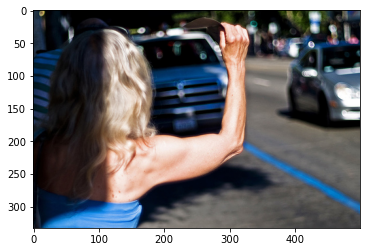

In [6]:
#Visualise both the images & text present in the dataset


plt.imshow(io.imread(all_imgs[42]))


print(all_imgs[42])

In [7]:
#Import the dataset and read the text file into a seperate variable

def load_doc(filename):
    
    with open(filename, 'r') as f:
        text = f.readlines()
    
    return text

text_file = 'captions.txt'
doc = load_doc(text_file)
print(doc[:300])

['image,caption\n', '1000268201_693b08cb0e.jpg,A child in a pink dress is climbing up a set of stairs in an entry way .\n', '1000268201_693b08cb0e.jpg,A girl going into a wooden building .\n', '1000268201_693b08cb0e.jpg,A little girl climbing into a wooden playhouse .\n', '1000268201_693b08cb0e.jpg,A little girl climbing the stairs to her playhouse .\n', '1000268201_693b08cb0e.jpg,A little girl in a pink dress going into a wooden cabin .\n', '1001773457_577c3a7d70.jpg,A black dog and a spotted dog are fighting\n', '1001773457_577c3a7d70.jpg,A black dog and a tri-colored dog playing with each other on the road .\n', '1001773457_577c3a7d70.jpg,A black dog and a white dog with brown spots are staring at each other in the street .\n', '1001773457_577c3a7d70.jpg,Two dogs of different breeds looking at each other on the road .\n', '1001773457_577c3a7d70.jpg,Two dogs on pavement moving toward each other .\n', '1002674143_1b742ab4b8.jpg,A little girl covered in paint sits in front of a painted

Create a dataframe which summarizes the image, path & captions as a dataframe

Each image id has 5 captions associated with it therefore the total dataset should have 40455 samples.

In [8]:
all_img_id= [i.split(',')[0] for i in doc[1:]]                            #store all the image id here
all_img_vector= [f"Images//{i.split(',')[0]}" for i in doc[1:]]           #store all the image path here
annotations= [(i.split(',')[1]).strip('.\n') for i in doc[1:]]             #store all the captions here

df = pd.DataFrame(list(zip(all_img_id, all_img_vector,annotations)),columns =['ID','Path', 'Captions']) 
    
df

,ID,Path,Captions
0,1000268201_693b08cb0e.jpg,Images//1000268201_693b08cb0e.jpg,A child in a pink dress is climbing up a set of stairs in an entry way
1,1000268201_693b08cb0e.jpg,Images//1000268201_693b08cb0e.jpg,A girl going into a wooden building
2,1000268201_693b08cb0e.jpg,Images//1000268201_693b08cb0e.jpg,A little girl climbing into a wooden playhouse
3,1000268201_693b08cb0e.jpg,Images//1000268201_693b08cb0e.jpg,A little girl climbing the stairs to her playhouse
4,1000268201_693b08cb0e.jpg,Images//1000268201_693b08cb0e.jpg,A little girl in a pink dress going into a wooden cabin
5,1001773457_577c3a7d70.jpg,Images//1001773457_577c3a7d70.jpg,A black dog and a spotted dog are fighting
6,1001773457_577c3a7d70.jpg,Images//1001773457_577c3a7d70.jpg,A black dog and a tri-colored dog playing with each other on the road
7,1001773457_577c3a7d70.jpg,Images//1001773457_577c3a7d70.jpg,A black dog and a white dog with brown spots are staring at each other in the street
8,1001773457_577c3a7d70.jpg,Images//1001773457_577c3a7d70.jpg,Two dogs of different breeds looking at each other on the road
9,1001773457_577c3a7d70.jpg,Images//1001773457_577c3a7d70.jpg,Two dogs on pavement moving toward each other


In [9]:
#Create a list which contains all the captions
# annotations= [(i.split(',')[1]).strip('.\n') for i in doc[1:]] done in previous cell block

#add the <start> & <end> token to all those captions as well

df['Captions'] = df['Captions'].apply(lambda cc : '<start>' + ' ' + cc + ' ' + '<end>')

annotations = [ '<start>' + ' ' + cc.strip() + ' ' + '<end>' for cc in annotations]

#Create a list which contains all the path to the images

all_img_path =  df.Path.unique().tolist()               #write your code here

print("Total captions present in the dataset: "+ str(len(annotations)))
print("Total images present in the dataset: " + str(len(all_img_path)))

Total captions present in the dataset: 40455
Total images present in the dataset: 8091


In [10]:
annotations[:15]         # Looking over first 15 captions

['<start> A child in a pink dress is climbing up a set of stairs in an entry way <end>',
 '<start> A girl going into a wooden building <end>',
 '<start> A little girl climbing into a wooden playhouse <end>',
 '<start> A little girl climbing the stairs to her playhouse <end>',
 '<start> A little girl in a pink dress going into a wooden cabin <end>',
 '<start> A black dog and a spotted dog are fighting <end>',
 '<start> A black dog and a tri-colored dog playing with each other on the road <end>',
 '<start> A black dog and a white dog with brown spots are staring at each other in the street <end>',
 '<start> Two dogs of different breeds looking at each other on the road <end>',
 '<start> Two dogs on pavement moving toward each other <end>',
 '<start> A little girl covered in paint sits in front of a painted rainbow with her hands in a bowl <end>',
 '<start> A little girl is sitting in front of a large painted rainbow <end>',
 '<start> A small girl in the grass plays with fingerpaints in f

In [11]:
df.head(10)         # Looking over first 10 rows of our dataframe

,ID,Path,Captions
0,1000268201_693b08cb0e.jpg,Images//1000268201_693b08cb0e.jpg,<start> A child in a pink dress is climbing up a set of stairs in an entry way <end>
1,1000268201_693b08cb0e.jpg,Images//1000268201_693b08cb0e.jpg,<start> A girl going into a wooden building <end>
2,1000268201_693b08cb0e.jpg,Images//1000268201_693b08cb0e.jpg,<start> A little girl climbing into a wooden playhouse <end>
3,1000268201_693b08cb0e.jpg,Images//1000268201_693b08cb0e.jpg,<start> A little girl climbing the stairs to her playhouse <end>
4,1000268201_693b08cb0e.jpg,Images//1000268201_693b08cb0e.jpg,<start> A little girl in a pink dress going into a wooden cabin <end>
5,1001773457_577c3a7d70.jpg,Images//1001773457_577c3a7d70.jpg,<start> A black dog and a spotted dog are fighting <end>
6,1001773457_577c3a7d70.jpg,Images//1001773457_577c3a7d70.jpg,<start> A black dog and a tri-colored dog playing with each other on the road <end>
7,1001773457_577c3a7d70.jpg,Images//1001773457_577c3a7d70.jpg,<start> A black dog and a white dog with brown spots are staring at each other in the street <end>
8,1001773457_577c3a7d70.jpg,Images//1001773457_577c3a7d70.jpg,<start> Two dogs of different breeds looking at each other on the road <end>
9,1001773457_577c3a7d70.jpg,Images//1001773457_577c3a7d70.jpg,<start> Two dogs on pavement moving toward each other <end>


In [12]:
#Create the vocabulary & the counter for the captions

vocabulary= [word.lower() for cc in df.Captions for word in cc.split() if word not in ('<start>','<end>')]

    
val_count  =  collections.Counter(vocabulary) # Using counter from collections to perform vocabulary counting


val_count

Counter({'a': 60196,
         'child': 1507,
         'in': 18174,
         'pink': 702,
         'dress': 332,
         'is': 9069,
         'climbing': 490,
         'up': 1215,
         'set': 105,
         'of': 6495,
         'stairs': 109,
         'an': 2325,
         'entry': 1,
         'way': 48,
         'girl': 3277,
         'going': 145,
         'into': 1046,
         'wooden': 278,
         'building': 485,
         'little': 1736,
         'playhouse': 6,
         'the': 17507,
         'to': 3005,
         'her': 1102,
         'cabin': 4,
         'black': 3620,
         'dog': 7948,
         'and': 8057,
         'spotted': 36,
         'are': 3365,
         'fighting': 130,
         'tri-colored': 12,
         'playing': 1954,
         'with': 7304,
         'each': 399,
         'other': 667,
         'on': 10357,
         'road': 380,
         'white': 3706,
         'brown': 2457,
         'spots': 28,
         'staring': 57,
         'at': 2810,
         'stree

In [13]:
vocabulary    # Looking at our vocabulary

['a',
 'child',
 'in',
 'a',
 'pink',
 'dress',
 'is',
 'climbing',
 'up',
 'a',
 'set',
 'of',
 'stairs',
 'in',
 'an',
 'entry',
 'way',
 'a',
 'girl',
 'going',
 'into',
 'a',
 'wooden',
 'building',
 'a',
 'little',
 'girl',
 'climbing',
 'into',
 'a',
 'wooden',
 'playhouse',
 'a',
 'little',
 'girl',
 'climbing',
 'the',
 'stairs',
 'to',
 'her',
 'playhouse',
 'a',
 'little',
 'girl',
 'in',
 'a',
 'pink',
 'dress',
 'going',
 'into',
 'a',
 'wooden',
 'cabin',
 'a',
 'black',
 'dog',
 'and',
 'a',
 'spotted',
 'dog',
 'are',
 'fighting',
 'a',
 'black',
 'dog',
 'and',
 'a',
 'tri-colored',
 'dog',
 'playing',
 'with',
 'each',
 'other',
 'on',
 'the',
 'road',
 'a',
 'black',
 'dog',
 'and',
 'a',
 'white',
 'dog',
 'with',
 'brown',
 'spots',
 'are',
 'staring',
 'at',
 'each',
 'other',
 'in',
 'the',
 'street',
 'two',
 'dogs',
 'of',
 'different',
 'breeds',
 'looking',
 'at',
 'each',
 'other',
 'on',
 'the',
 'road',
 'two',
 'dogs',
 'on',
 'pavement',
 'moving',
 'towa

In [14]:
#Visualise the top 30 occuring words in the captions

val_count.most_common()[:30]

[('a', 60196),
 ('in', 18174),
 ('the', 17507),
 ('on', 10357),
 ('is', 9069),
 ('and', 8057),
 ('dog', 7948),
 ('with', 7304),
 ('man', 7137),
 ('of', 6495),
 ('two', 5132),
 ('white', 3706),
 ('black', 3620),
 ('boy', 3514),
 ('are', 3365),
 ('woman', 3304),
 ('girl', 3277),
 ('to', 3005),
 ('wearing', 2916),
 ('people', 2811),
 ('at', 2810),
 ('water', 2676),
 ('young', 2587),
 ('red', 2553),
 ('brown', 2457),
 ('an', 2325),
 ('his', 2255),
 ('blue', 2125),
 ('dogs', 2095),
 ('running', 1996)]

In [15]:
def plot_t30():          # Creating a function to plot the count for top 30 words using seaborn barplot
    
    fig = plt.figure(figsize =(18, 10))
    plt.title('Most commonly occuring 30 words')
    plt.xlabel('words')
    plt.xticks(rotation='30')
    plt.ylabel('count')
    sns.barplot(y = cnt, x = most)
    plt.show()

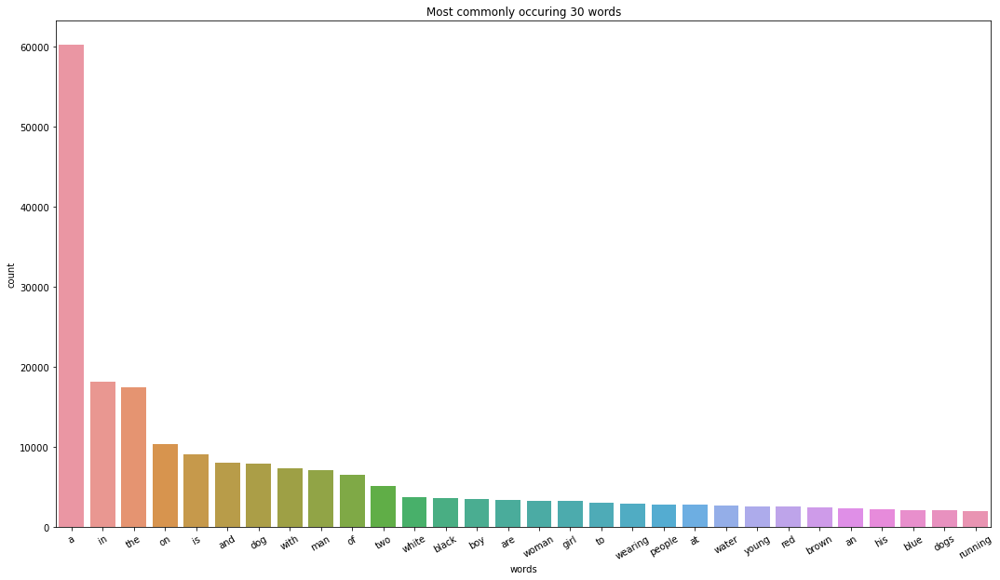

In [16]:
# Visualizing the plot by running a for loop through count of our vocabulary

most = []
cnt = []
for i,z in val_count.most_common()[:30]:
    most.append(i)
    cnt.append(z)

plot_t30()

40                                                    <start> A boy smiles in front of a stony wall in a city  <end>
41          <start> A little boy is standing on the street while a man in overalls is working on a stone wall  <end>
42                                                                  <start> A young boy runs aross the street  <end>
43            <start> A young child is walking on a stone paved street with a metal pole and a man behind him  <end>
44    <start> Smiling boy in white shirt and blue jeans in front of rock wall with man in overalls behind him  <end>
Name: Captions, dtype: object


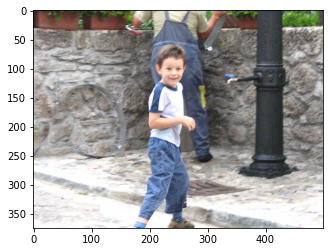

In [17]:
# Visualise both the images & captions present in the dataset


plt.imshow(io.imread(df.Path[42]))


print(df[df['Path'] == df['Path'][42]].Captions)

## Pre-Processing the captions
1.Create the tokenized vectors by tokenizing the captions fore ex :split them using spaces & other filters. 
This gives us a vocabulary of all of the unique words in the data. Keep the total vocaublary to top 5,000 words for saving memory.

2.Replace all other words with the unknown token "UNK" .

3.Create word-to-index and index-to-word mappings.

4.Pad all sequences to be the same length as the longest one.

In [18]:
# create the tokenizer
Token = tf.keras.preprocessing.text.Tokenizer(
        num_words=5001,
        filters='!"#$%&()*+.,-/:;=?@[\]^_`{|}~ ',
        lower=True,
        char_level=False,
        oov_token='UNK')

In [19]:
# Create word-to-index and index-to-word mappings.

Token.fit_on_texts(annotations)                      # word-to-index 

cc_token = Token.texts_to_sequences(annotations)     # index-to-word

Token.index_word

{1: 'UNK',
 2: 'a',
 3: '<start>',
 4: '<end>',
 5: 'in',
 6: 'the',
 7: 'on',
 8: 'is',
 9: 'and',
 10: 'dog',
 11: 'with',
 12: 'man',
 13: 'of',
 14: 'two',
 15: 'white',
 16: 'black',
 17: 'boy',
 18: 'are',
 19: 'woman',
 20: 'girl',
 21: 'to',
 22: 'wearing',
 23: 'people',
 24: 'at',
 25: 'water',
 26: 'young',
 27: 'red',
 28: 'brown',
 29: 'an',
 30: 'his',
 31: 'blue',
 32: 'dogs',
 33: 'running',
 34: 'through',
 35: 'playing',
 36: 'shirt',
 37: 'while',
 38: 'down',
 39: 'little',
 40: 'standing',
 41: 'ball',
 42: 'grass',
 43: 'person',
 44: 'child',
 45: 'snow',
 46: 'jumping',
 47: 'over',
 48: 'three',
 49: 'front',
 50: 'sitting',
 51: 'small',
 52: 'up',
 53: 'field',
 54: 'holding',
 55: 'large',
 56: 'group',
 57: 'by',
 58: 'green',
 59: 'yellow',
 60: 'children',
 61: 'walking',
 62: 'men',
 63: 'her',
 64: 'into',
 65: 'beach',
 66: 'air',
 67: 'near',
 68: 'jumps',
 69: 'mouth',
 70: 'street',
 71: 'runs',
 72: 'for',
 73: 'another',
 74: 'riding',
 75: 'from'

In [20]:
cc_token[:5]  # Looking at our tokens

[[3, 2, 44, 5, 2, 89, 173, 8, 116, 52, 2, 389, 13, 385, 5, 29, 1, 670, 4],
 [3, 2, 20, 313, 64, 2, 197, 120, 4],
 [3, 2, 39, 20, 116, 64, 2, 197, 2368, 4],
 [3, 2, 39, 20, 116, 6, 385, 21, 63, 2368, 4],
 [3, 2, 39, 20, 5, 2, 89, 173, 313, 64, 2, 197, 2887, 4]]

In [21]:
# Create a word count of your tokenizer to visulize the Top 30 occuring words after text processing

Token_count = json.loads(json.dumps(Token.word_counts))

Token_count = {k: v for k, v in sorted(Token_count.items(), key=lambda item: item[1], reverse = True)[:32] } # Sorting dictionary based on values from key in descending order and slicing top 30

Token_count

{'a': 61436,
 '<start>': 40455,
 '<end>': 40455,
 'in': 18193,
 'the': 17677,
 'on': 10369,
 'is': 9069,
 'and': 8066,
 'dog': 7958,
 'with': 7308,
 'man': 7172,
 'of': 6504,
 'two': 5550,
 'white': 3728,
 'black': 3641,
 'boy': 3534,
 'are': 3365,
 'woman': 3320,
 'girl': 3284,
 'to': 3008,
 'wearing': 2917,
 'people': 2837,
 'at': 2820,
 'water': 2683,
 'young': 2610,
 'red': 2571,
 'brown': 2484,
 'an': 2358,
 'his': 2255,
 'blue': 2136,
 'dogs': 2097,
 'running': 1996}

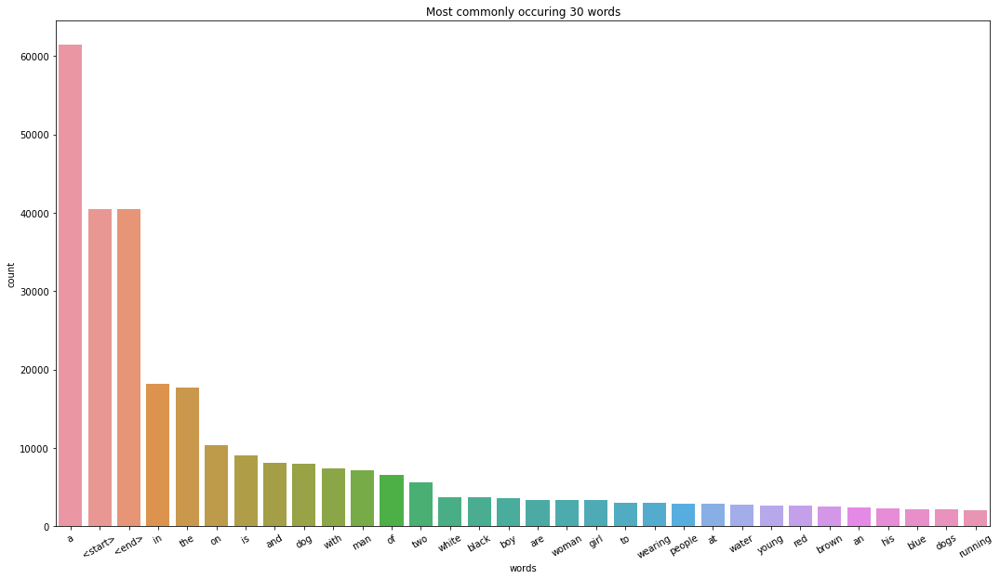

In [22]:
# Using for loop to visualize top 30 (32 if we count <start> and <end>) words in our token

most = []
cnt = []
for i in Token_count:
    most.append(i)
    cnt.append(Token_count[i])
    
plot_t30()

We can see that the plot is exactly the same as before 

In [23]:
# Pad each vector to the max_length of the captions ^ store it to a vairable

len_cc = [len(cc) for cc in cc_token]                                                          # cc signify closed captions

max_len_cc = max(len_cc)

cap_vector= tf.keras.preprocessing.sequence.pad_sequences(cc_token,
                                                          padding = 'post', 
                                                          maxlen = max_len_cc,
                                                          dtype = 'int32', 
                                                          value = 0)


print("The shape of Caption vector is :" + str(cap_vector.shape))

The shape of Caption vector is :(40455, 35)


## Pre-processing the images

1.Resize them into the shape of (299, 299)

3.Normalize the image within the range of -1 to 1, such that it is in correct format for InceptionV3. 

### FAQs on how to resize the images::
* Since you have a list which contains all the image path, you need to first convert them to a dataset using <i>tf.data.Dataset.from_tensor_slices</i>. Once you have created a dataset consisting of image paths, you need to apply a function to the dataset which will apply the necessary preprocessing to each image. 
* This function should resize them and also should do the necessary preprocessing that it is in correct format for InceptionV3.


In [24]:
all_img_path[:10]                           #write your code here to create the dataset consisting of image paths

['Images//1000268201_693b08cb0e.jpg',
 'Images//1001773457_577c3a7d70.jpg',
 'Images//1002674143_1b742ab4b8.jpg',
 'Images//1003163366_44323f5815.jpg',
 'Images//1007129816_e794419615.jpg',
 'Images//1007320043_627395c3d8.jpg',
 'Images//1009434119_febe49276a.jpg',
 'Images//1012212859_01547e3f17.jpg',
 'Images//1015118661_980735411b.jpg',
 'Images//1015584366_dfcec3c85a.jpg']

In [25]:
tf.keras.backend.image_data_format()

'channels_last'

In [26]:
#write your code here for creating the function. This function should return images & their path

def load_image(path_dataset):
    img = tf.io.read_file(path_dataset)
    img = tf.image.decode_jpeg(img, channels=3)
    img = tf.image.resize(img, (299, 299))
    img = tf.keras.applications.inception_v3.preprocess_input(img, data_format=None)
    return img, path_dataset

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


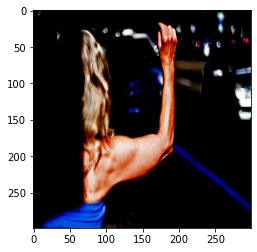

(299, 299, 3)
Images//1056338697_4f7d7ce270.jpg


In [27]:
#write your code here for applying the function to the image path dataset, such that the transformed dataset should contain images & their path


plt.imshow(load_image(all_img_path[42])[0])
plt.show()

print(load_image(all_img_path[42])[0].shape)
print(load_image(all_img_path[42])[1])



In [28]:
img_df = tf.data.Dataset.from_tensor_slices(all_img_path)

img_df = img_df.map(load_image, num_parallel_calls=tf.data.experimental.AUTOTUNE)
       
img_df = img_df.batch(64, drop_remainder = False)

img_df

<BatchDataset shapes: ((None, 299, 299, 3), (None,)), types: (tf.float32, tf.string)>

## Load the pretrained Imagenet weights of Inception net V3

1.To save the memory(RAM) from getting exhausted, extract the features of the images using the last layer of pre-trained model. Including this as part of training will lead to higher computational time.

2.The shape of the output of this layer is 8x8x2048. 

3.Use a function to extract the features of each image in the train & test dataset such that the shape of each image should be (batch_size, 8*8, 2048)



In [29]:
image_model = tf.keras.applications.InceptionV3(include_top=False,weights='imagenet')

new_input = image_model.input                 #write code here to get the input of the image_model
hidden_layer = image_model.layers[-1].output  #write code here to get the output of the image_model

image_features_extract_model = tf.compat.v1.keras.Model(new_input, hidden_layer)   #build the final model using both input & output layer

image_features_extract_model.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, None, None, 3 864         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, None, None, 3 96          conv2d[0][0]                     
__________________________________________________________________________________________________
activation (Activation)         (None, None, None, 3 0           batch_normalization[0][0]        
______________________________________________________________________________________________

In [30]:
# write the code to apply the feature_extraction model to your earlier created dataset which contained images & their respective paths
# Once the features are created, you need to reshape them such that feature shape is in order of (batch_size, 8*8, 2048)

feature_dict = {}

for img,path in tqdm(img_df):
    
    batch_features = image_features_extract_model(img)
    batch_features_flat = tf.reshape(batch_features,(batch_features.shape[0], -1, batch_features.shape[3]))
    
    
    for bf, p in zip(batch_features_flat, path):
        feature_path = p.numpy().decode("utf-8")
        feature_dict[feature_path] = bf.numpy()

100%|████████████████████████████████████████████████████████████████████████████████| 127/127 [00:20<00:00,  6.12it/s]


In [31]:
batch_features

<tf.Tensor: shape=(27, 8, 8, 2048), dtype=float32, numpy=
array([[[[0.00000000e+00, 7.48490319e-02, 0.00000000e+00, ...,
          2.31228232e-01, 0.00000000e+00, 0.00000000e+00],
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          1.07692696e-01, 0.00000000e+00, 0.00000000e+00],
         [0.00000000e+00, 1.94464281e-01, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 1.84740812e-01],
         ...,
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          9.45291296e-02, 0.00000000e+00, 5.05976319e-01],
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00]],

        [[0.00000000e+00, 4.22643602e-01, 1.03321243e-02, ...,
          2.33424723e-01, 0.00000000e+00, 0.00000000e+00],
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
         

In [32]:
batch_features_flat

<tf.Tensor: shape=(27, 64, 2048), dtype=float32, numpy=
array([[[0.        , 0.07484903, 0.        , ..., 0.23122823,
         0.        , 0.        ],
        [0.        , 0.        , 0.        , ..., 0.1076927 ,
         0.        , 0.        ],
        [0.        , 0.19446428, 0.        , ..., 0.        ,
         0.        , 0.18474081],
        ...,
        [0.        , 0.        , 0.        , ..., 0.        ,
         1.6611009 , 0.        ],
        [0.        , 0.39760223, 0.        , ..., 0.        ,
         0.32383063, 0.        ],
        [0.        , 2.5326214 , 0.        , ..., 0.        ,
         0.        , 0.        ]],

       [[0.        , 0.        , 0.        , ..., 1.2504578 ,
         0.        , 0.        ],
        [0.        , 0.        , 0.07787158, ..., 1.206025  ,
         0.        , 0.        ],
        [0.        , 0.        , 0.        , ..., 0.6320966 ,
         0.        , 0.        ],
        ...,
        [0.8739969 , 0.        , 1.6433312 , ..., 0.

### FAQs on how to store the features:
* You can store the features using a dictionary with the path as the key and values as the feature extracted by the inception net v3 model OR
* You can store using numpy(np.save) to store the resulting vector.

## Dataset creation
1.Apply train_test_split on both image path & captions to create the train & test list. Create the train-test spliit using 80-20 ratio & random state = 42

2.Create a function which maps the image path to their feature. 

3.Create a builder function to create train & test dataset & apply the function created earlier to transform the dataset

2.Make sure you have done Shuffle and batch while building the dataset

3.The shape of each image in the dataset after building should be (batch_size, 8*8, 2048)

4.The shape of each caption in the dataset after building should be(batch_size, max_len)


In [33]:
#write your code here

path_train, path_test, cap_train, cap_test = train_test_split(all_img_vector,cap_vector,test_size=0.2,random_state=42)

In [34]:
print("Training data for images: " + str(len(path_train)))
print("Testing data for images: " + str(len(path_test)))
print("Training data for Captions: " + str(len(cap_train)))
print("Testing data for Captions: " + str(len(cap_test)))

Training data for images: 32364
Testing data for images: 8091
Training data for Captions: 32364
Testing data for Captions: 8091


In [35]:
# Create a function which maps the image path to their feature. 
# This function will take the image_path & caption and return it's feature & respective caption.

def map_func(img,cc):
    img_tensor = np.load(img.decode('utf-8')+'.npy')
    return img_tensor, cc

### FAQs on how to load the features:
* You can load the features using the dictionary created earlier OR
* You can store using numpy(np.load) to load the feature vector.

In [36]:
# create a builder function to create dataset which takes in the image path & captions as input
# This function should transform the created dataset(img_path,cap) to (features,cap) using the map_func created earlier

def gen_dataset(img, cc):
    
    dataset = tf.data.Dataset.from_tensor_slices((img, cc))
    
    dataset = dataset.map(lambda x, y: 
                          tf.numpy_function(map_func, [x, y], [tf.float32, tf.int32]),
                          num_parallel_calls = tf.data.experimental.AUTOTUNE)
    
    
    dataset = (dataset.shuffle(1000, reshuffle_each_iteration=True)
               .batch(64, drop_remainder=False)
               .prefetch(tf.data.experimental.AUTOTUNE))

    
    return dataset

In [37]:
train_dataset=gen_dataset(path_train,cap_train)
test_dataset=gen_dataset(path_test,cap_test)

In [38]:
sample_img_batch, sample_cap_batch = next(iter(train_dataset))
print(sample_img_batch.shape)  #(batch_size, 8*8, 2048)
print(sample_cap_batch.shape) #(batch_size,max_len)

(64, 64, 2048)
(64, 35)


## Model Building
1.Set the parameters

2.Build the Encoder, Attention model & Decoder

In [39]:
embedding_dim = 256 
units = 512
vocab_size = 5001                            #top 5,000 words +1
train_num_steps =  len(path_train) // 64     #len(total train images) // BATCH_SIZE
test_num_steps =   len(path_test)  // 64     #len(total test images) // BATCH_SIZE

attention_features_shape = bf.shape[0]

print(train_num_steps,test_num_steps)



505 126


### Encoder

In [40]:
tf.compat.v1.reset_default_graph()

In [41]:
class Encoder(Model):
    def __init__(self,embed_dim):
        super(Encoder, self).__init__()
        self.dense = tf.keras.layers.Dense(embed_dim)                #build your Dense layer with relu activation
        
    def call(self, features):
        features = self.dense(features)         # extract the features from the image shape: (batch, 8*8, embed_dim)
        features = tf.nn.relu(features)
        return features

In [42]:
encoder=Encoder(embedding_dim)

### Attention model

In [43]:
class Attention_model(Model):
    def __init__(self, units):
        super(Attention_model, self).__init__()
        self.W1 = tf.keras.layers.Dense(units)            #build your Dense layer
        self.W2 = tf.keras.layers.Dense(units)            #build your Dense layer
        self.V = tf.keras.layers.Dense(1)                 #build your final Dense layer with unit 1
        self.units=units

    def call(self, features, hidden):
        #features shape: (batch_size, 8*8, embedding_dim)
        # hidden shape: (batch_size, hidden_size)
        hidden_with_time_axis =  tf.expand_dims(hidden,1)# Expand the hidden shape to shape: (batch_size, 1, hidden_size)
        # attention_hidden_layer shape == (batch_size, 64, units)
        attention_hidden_layer = (tf.nn.tanh(self.W1(features) +
                                            self.W2(hidden_with_time_axis)))
        score = self.V(attention_hidden_layer)# build your score funciton to shape: (batch_size, 8*8, units)
        attention_weights =  tf.nn.softmax(score,axis=1)# extract your attention weights with shape: (batch_size, 8*8, 1)
        context_vector =  attention_weights * features#shape: create the context vector with shape (batch_size, 8*8,embedding_dim)
        context_vector =  tf.reduce_sum(context_vector, axis=1)# reduce the shape to (batch_size, embedding_dim)
        

        return context_vector, attention_weights

### Decoder

In [44]:
class Decoder(Model):
    def __init__(self, embed_dim, units, vocab_size):
        super(Decoder, self).__init__()
        self.units=units
        self.attention = Attention_model(self.units)      #iniitalise your Attention model with units
        self.embed = tf.keras.layers.Embedding(vocab_size, embed_dim) #build your Embedding layer
        self.gru = tf.keras.layers.GRU(self.units,return_sequences=True,return_state=True,recurrent_initializer='glorot_uniform')
        self.d1 = tf.keras.layers.Dense(self.units)     #build your Dense layer
        self.d2 = tf.keras.layers.Dense(vocab_size)     #build your Dense layer
        

    def call(self, x, features, hidden):
        context_vector, attention_weights = self.attention(features, hidden) #create your context vector & attention weights from attention model
        embed =  self.embed(x)# embed your input to shape: (batch_size, 1, embedding_dim)
        embed =  tf.concat([tf.expand_dims(context_vector, 1), embed], axis=-1) # Concatenate your input with the context vector from attention layer. Shape: (batch_size, 1, embedding_dim + embedding_dim)
        output,state = self.gru(embed)# Extract the output & hidden state from GRU layer. Output shape : (batch_size, max_length, hidden_size)
        output = self.d1(output)
        output = tf.reshape(output, (-1, output.shape[2])) # shape : (batch_size * max_length, hidden_size)
        output = self.d2(output) # shape : (batch_size * max_length, vocab_size)
        
        return output,state, attention_weights
    
    def init_state(self, batch_size):
        return tf.zeros((batch_size, self.units))

In [45]:
decoder=Decoder(embedding_dim, units, vocab_size)

In [46]:
features=encoder(sample_img_batch)

hidden = decoder.init_state(batch_size=sample_cap_batch.shape[0])
dec_input = tf.expand_dims([Token.word_index['<start>']] * sample_cap_batch.shape[0], 1)

predictions, hidden_out, attention_weights= decoder(dec_input, features, hidden)
print('Feature shape from Encoder: {}'.format(features.shape)) #(batch, 8*8, embed_dim)
print('Predcitions shape from Decoder: {}'.format(predictions.shape)) #(batch,vocab_size)
print('Attention weights shape from Decoder: {}'.format(attention_weights.shape)) #(batch, 8*8, embed_dim)

Feature shape from Encoder: (64, 64, 256)
Predcitions shape from Decoder: (64, 5001)
Attention weights shape from Decoder: (64, 64, 1)


## Model training & optimization
1.Set the optimizer & loss object

2.Create your checkpoint path

3.Create your training & testing step functions

4.Create your loss function for the test dataset

In [47]:
optimizer = tf.keras.optimizers.Adam(lr = 0.001)   #define the optimizer
loss_object = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True,  reduction=tf.keras.losses.Reduction.NONE)  #define your loss object

In [48]:
def loss_function(real, pred):
    mask = tf.math.logical_not(tf.math.equal(real, 0))
    loss_ = loss_object(real, pred)

    mask = tf.cast(mask, dtype=loss_.dtype)
    loss_ *= mask

    return tf.reduce_mean(loss_)

In [49]:
checkpoint_path = "Flickr8K/checkpoints/train"
ckpt = tf.train.Checkpoint(encoder=encoder,
                           decoder=decoder,
                           optimizer = optimizer)
ckpt_manager = tf.train.CheckpointManager(ckpt, checkpoint_path, max_to_keep=5)

In [50]:
start_epoch = 0
if ckpt_manager.latest_checkpoint:
    start_epoch = int(ckpt_manager.latest_checkpoint.split('-')[-1])

* While creating the training step for your model, you will apply Teacher forcing.
* Teacher forcing is a technique where the target/real word is passed as the next input to the decoder instead of previous prediciton.

In [51]:
@tf.function
def train_step(img_tensor, target):
    loss = 0
    hidden = decoder.init_state(batch_size=target.shape[0])
    dec_input = tf.expand_dims([Token.word_index['<start>']] * target.shape[0], 1)
    
    with tf.GradientTape() as tape:
        encoder_output = encoder(img_tensor)
        for i in range(1, target.shape[1]):
            pred, hidden, _ =decoder(dec_input, encoder_output, hidden)
            loss += loss_function(target[:,i], pred)
            dec_input = tf.expand_dims(target[:,i], 1)
    avg_loss = (loss/int(target.shape[1]))
    tot_trainables_variables = encoder.trainable_variables + decoder.trainable_variables
    gradients = tape.gradient(loss, tot_trainables_variables)
    optimizer.apply_gradients(zip(gradients, tot_trainables_variables))
        
    return loss, avg_loss

* While creating the test step for your model, you will pass your previous prediciton as the next input to the decoder.

In [52]:
@tf.function
def test_step(img_tensor, target):
    loss = 0
    hidden = decoder.init_state(batch_size=target.shape[0])
    dec_input = tf.expand_dims([Token.word_index['<start>']] * target.shape[0], 1)

    with tf.GradientTape() as tape:
        encoder_output = encoder(img_tensor)
        for i in range(1,target.shape[1]):
            pred,hidden,_ = decoder(dec_input,encoder_output,hidden)
            loss += loss_function(target[:,i], pred)
            dec_input = tf.expand_dims(target[:,i], 1)

    avg_loss = (loss / int(target.shape[1]))
    
    tot_trainables_variables = encoder.trainable_variables + decoder.trainable_variables
    gradients = tape.gradient(loss, tot_trainables_variables)
    optimizer.apply_gradients(zip(gradients, tot_trainables_variables))
        
    return loss, avg_loss

In [53]:
def test_loss_cal(test_dataset):
    total_loss = 0

    for (batch,(img_tensor,target)) in enumerate(test_dataset):
        batch_loss,t_loss = test_step(img_tensor, target)
        total_loss += t_loss
        
    avg_test_loss = total_loss/test_num_steps
    
    return avg_test_loss

In [54]:
loss_plot = []
test_loss_plot = []
EPOCHS = 15

best_test_loss=100
for epoch in tqdm(range(0, EPOCHS)):
    start = time.time()
    total_loss = 0

    for (batch, (img_tensor, target)) in enumerate(train_dataset):
        batch_loss, t_loss = train_step(img_tensor, target)
        total_loss += t_loss
        avg_train_loss=total_loss / train_num_steps
        
    loss_plot.append(avg_train_loss)    
    test_loss = test_loss_cal(test_dataset)
    test_loss_plot.append(test_loss)
    
    print ('For epoch: {}, the train loss is {:.3f}, & test loss is {:.3f}'.format(epoch+1,avg_train_loss,test_loss))
    print ('Time taken for 1 epoch {} sec\n'.format(time.time() - start))
    
    if test_loss < best_test_loss:
        print('Test loss has been reduced from %.3f to %.3f' % (best_test_loss, test_loss))
        best_test_loss = test_loss
        ckpt_manager.save()

  0%|                                                                                           | 0/15 [00:00<?, ?it/s]

For epoch: 1, the train loss is 1.363, & test loss is 1.126
Time taken for 1 epoch 126.17801594734192 sec

Test loss has been reduced from 100.000 to 1.126


 13%|██████████▉                                                                       | 2/15 [03:09<23:15, 107.37s/it]

For epoch: 2, the train loss is 1.037, & test loss is 0.987
Time taken for 1 epoch 62.84208869934082 sec

Test loss has been reduced from 1.126 to 0.987
For epoch: 3, the train loss is 0.938, & test loss is 0.907
Time taken for 1 epoch 65.55120086669922 sec

Test loss has been reduced from 0.987 to 0.907


 20%|████████████████▌                                                                  | 3/15 [04:15<18:58, 94.88s/it]

For epoch: 4, the train loss is 0.871, & test loss is 0.848
Time taken for 1 epoch 63.403820276260376 sec

Test loss has been reduced from 0.907 to 0.848


 27%|██████████████████████▏                                                            | 4/15 [05:18<15:40, 85.49s/it]

For epoch: 5, the train loss is 0.819, & test loss is 0.800
Time taken for 1 epoch 61.6975998878479 sec

Test loss has been reduced from 0.848 to 0.800


 40%|█████████████████████████████████▏                                                 | 6/15 [07:21<10:59, 73.23s/it]

For epoch: 6, the train loss is 0.772, & test loss is 0.757
Time taken for 1 epoch 60.955039501190186 sec

Test loss has been reduced from 0.800 to 0.757


 47%|██████████████████████████████████████▋                                            | 7/15 [08:22<09:16, 69.57s/it]

For epoch: 7, the train loss is 0.732, & test loss is 0.718
Time taken for 1 epoch 60.822078227996826 sec

Test loss has been reduced from 0.757 to 0.718


 53%|████████████████████████████████████████████▎                                      | 8/15 [09:24<07:50, 67.17s/it]

For epoch: 8, the train loss is 0.695, & test loss is 0.682
Time taken for 1 epoch 61.407707929611206 sec

Test loss has been reduced from 0.718 to 0.682


 60%|█████████████████████████████████████████████████▊                                 | 9/15 [10:26<06:33, 65.55s/it]

For epoch: 9, the train loss is 0.662, & test loss is 0.648
Time taken for 1 epoch 61.57018256187439 sec

Test loss has been reduced from 0.682 to 0.648


 67%|██████████████████████████████████████████████████████▋                           | 10/15 [11:27<05:21, 64.26s/it]

For epoch: 10, the train loss is 0.630, & test loss is 0.617
Time taken for 1 epoch 61.05105519294739 sec

Test loss has been reduced from 0.648 to 0.617
For epoch: 11, the train loss is 0.601, & test loss is 0.588
Time taken for 1 epoch 60.916534662246704 sec

Test loss has been reduced from 0.617 to 0.588


 80%|█████████████████████████████████████████████████████████████████▌                | 12/15 [13:30<03:08, 62.81s/it]

For epoch: 12, the train loss is 0.576, & test loss is 0.564
Time taken for 1 epoch 60.833494424819946 sec

Test loss has been reduced from 0.588 to 0.564


 87%|███████████████████████████████████████████████████████████████████████           | 13/15 [14:31<02:04, 62.31s/it]

For epoch: 13, the train loss is 0.551, & test loss is 0.538
Time taken for 1 epoch 60.96757698059082 sec

Test loss has been reduced from 0.564 to 0.538
For epoch: 14, the train loss is 0.526, & test loss is 0.515
Time taken for 1 epoch 60.922608375549316 sec

Test loss has been reduced from 0.538 to 0.515


100%|██████████████████████████████████████████████████████████████████████████████████| 15/15 [16:33<00:00, 61.68s/it]

For epoch: 15, the train loss is 0.507, & test loss is 0.505
Time taken for 1 epoch 60.85950469970703 sec

Test loss has been reduced from 0.515 to 0.505


100%|██████████████████████████████████████████████████████████████████████████████████| 15/15 [16:33<00:00, 66.25s/it]


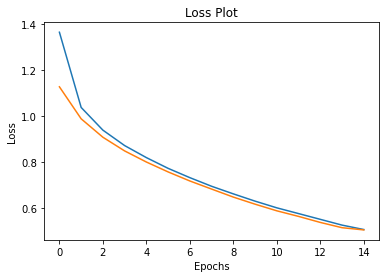

In [55]:
plt.plot(loss_plot)
plt.plot(test_loss_plot)
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Loss Plot')
plt.show()

#### NOTE: 
* Since there is a difference between the train & test steps ( Presence of teacher forcing), you may observe that the train loss is decreasing while your test loss is not. 
* This doesn't mean that the model is overfitting, as we can't compare the train & test results here, as both approach is different.
* Also, if you want to achieve better results you can run it more epochs, but the intent of this capstone is to give you an idea on how to integrate attention mechanism with E-D architecture for images. The intent is not to create the state of art model. 

## Model Evaluation
1.Define your evaluation function using greedy search

2.Define your evaluation function using beam search ( optional)

3.Test it on a sample data using BLEU score

### Greedy Search

In [56]:
def evaluate(image):
    attention_plot = np.zeros((max_len_cc, attention_features_shape))

    hidden = decoder.init_state(batch_size=1)

    temp_input = tf.expand_dims(load_image(image)[0], 0) #process the input image to desired format before extracting features
    img_tensor_val = image_features_extract_model(temp_input) # Extract features using our feature extraction model
    img_tensor_val = tf.reshape(img_tensor_val, (img_tensor_val.shape[0], -1, img_tensor_val.shape[3]))

    features = encoder(img_tensor_val) # extract the features by passing the input to encoder

    dec_input = tf.expand_dims([Token.word_index['<start>']], 0)
    result = []

    for i in range(max_len_cc):
        predictions, hidden, attention_weights = decoder(dec_input, features, hidden)  # get the output from decoder

        attention_plot[i] = tf.reshape(attention_weights, (-1, )).numpy()

        predicted_id = tf.argmax(predictions[0]).numpy()  #extract the predicted id(embedded value) which carries the max value
        result.append(Token.index_word[predicted_id])#map the id to the word from tokenizer and append the value to the result list

        if Token.index_word[predicted_id] == '<end>':
            return result, attention_plot,predictions

        dec_input = tf.expand_dims([predicted_id], 0)

    attention_plot = attention_plot[:len(result), :]
    return result, attention_plot,predictions


In [57]:
def plot_attmap(caption, weights, image):

    fig = plt.figure(figsize=(10, 10))
    temp_img = np.array(Image.open(image))
    
    len_cap = len(caption)
    for cap in range(len_cap):
        weights_img = np.reshape(weights[cap], (8,8))
        weights_img = np.array(Image.fromarray(weights_img).resize((224, 224), Image.LANCZOS))
        
        ax = fig.add_subplot(len_cap//2, len_cap//2, cap+1)
        ax.set_title(caption[cap], fontsize=15)
        
        img=ax.imshow(temp_img)
        
        ax.imshow(weights_img, cmap='gist_heat', alpha=0.6,extent=img.get_extent())
        ax.axis('off')
    plt.subplots_adjust(hspace=0.2, wspace=0.2)
    plt.show()

In [58]:
from nltk.translate.bleu_score import sentence_bleu

In [59]:
def filt_text(text):
    filt=['<start>','<unk>','<end>'] 
    temp= text.split()
    [temp.remove(j) for k in filt for j in temp if k==j]
    text=' '.join(temp)
    return text

In [60]:
# Defining a function to give prediction, evaluate and provide us with speech so that we may use it again



def Captioning(x, random, autoplay=False, weights=(0.25, 0.25 , 0.25, 0.25)):
    
    rid = np.random.randint(x, random)
    test_image = path_test[rid]
   

    real_caption = ' '.join([Token.index_word[i] for i in cap_test[rid] if i not in [0]])
    result, attention_plot,pred_test = evaluate(test_image)


    real_caption=filt_text(real_caption)      


    pred_caption=' '.join(result).rsplit(' ', 1)[0]

    real_appn = []
    real_appn.append(real_caption.split())
    reference = real_appn
    candidate = pred_caption.split()

    score  =  sentence_bleu(reference, candidate, weights= weights)   #set your weights)
    score1 =  sentence_bleu(reference, candidate, weights=(1,0,0,0))  # 1-gram score
    score2 =  sentence_bleu(reference, candidate, weights=(0,1,0,0))  # 2-gram score
    score3 =  sentence_bleu(reference, candidate, weights=(0,0,1,0))  # 3-gram score
    score4 =  sentence_bleu(reference, candidate, weights=(0,0,0,1))  # 4-gram score
    print(f"BELU score : {score*100}")
    print(f"1-gram score : {score1*100}")
    print(f"2-gram score : {score2*100}")
    print(f"3-gram score : {score3*100}")
    print(f"4-gram score : {score4*100}")

    print ('Real Caption:', real_caption)
    print ('Prediction Caption:', pred_caption)
    plot_attmap(result, attention_plot, test_image)


    #Let's use google text to speech online API from playing the predicted caption as audio
    speech = gTTS(pred_caption, lang = 'en', slow = False)
    speech.save('cc.mp3')
    audio_file = 'cc.mp3'
    display.display(display.Audio(audio_file, rate=None, autoplay=autoplay))
    
    return test_image

BELU score : 58.143073696821936
1-gram score : 80.0
2-gram score : 66.66666666666666
3-gram score : 50.0
4-gram score : 42.857142857142854
Real Caption: the black and white dog is running on the grass
Prediction Caption: a black and white dog is running through the grass


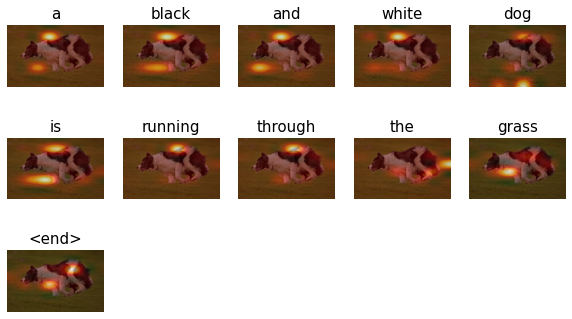

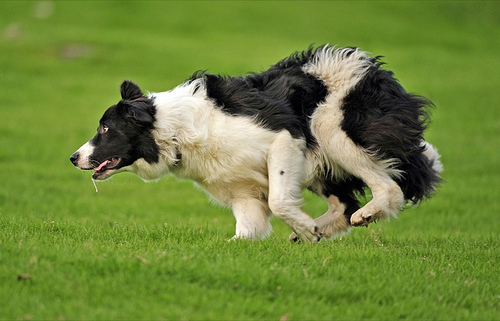

In [61]:
test_image = Captioning(18,19, True)
Image.open(test_image)

BELU score : 3.6901226086395757e-76
1-gram score : 30.0
2-gram score : 22.22222222222222
3-gram score : 12.500000000000004
4-gram score : 2.2250738585072627e-306
Real Caption: football players in uniform embrace one another
Prediction Caption: a group of football players in blue uniforms squat down


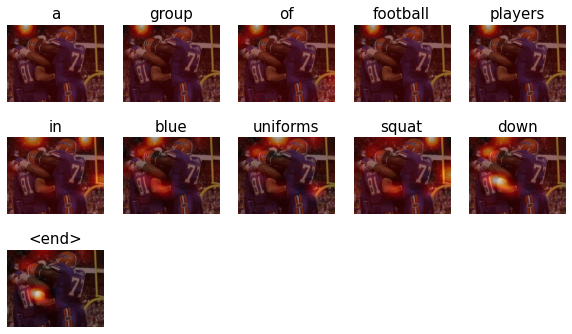

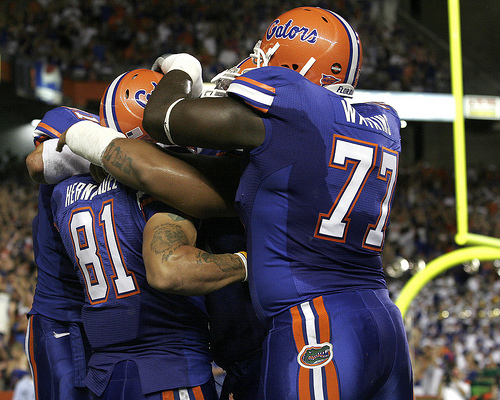

In [62]:
test_image = Captioning(0, len(path_test))
Image.open(test_image)

BELU score : 3.0390279664926973e-153
1-gram score : 20.056053079999273
2-gram score : 4.412331677599841
3-gram score : 9.817763870890899e-307
4-gram score : 9.817763870890899e-307
Real Caption: three man in hi viz jackets are pulling attempting to pull a trapped four wheel drive car from a ditch
Prediction Caption: three men in helmets and a vehicle out of a ditch


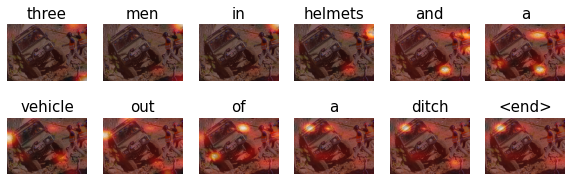

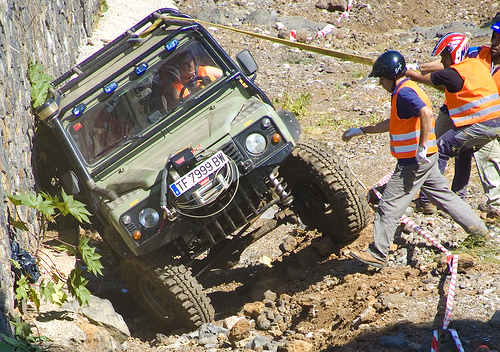

In [63]:
test_image = Captioning(0, len(path_test))
Image.open(test_image)

BELU score : 21.305413619585085
1-gram score : 37.5
2-gram score : 33.33333333333333
3-gram score : 21.428571428571423
4-gram score : 7.6923076923076925
Real Caption: a man steers a blue boat past brightly colored houses
Prediction Caption: a man steers a boat in a canal lined with a blue boat in a boat


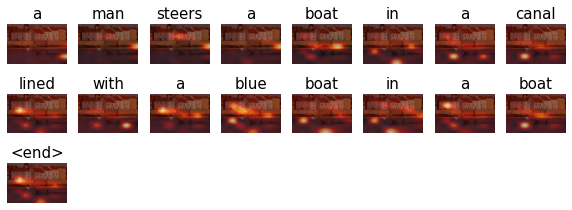

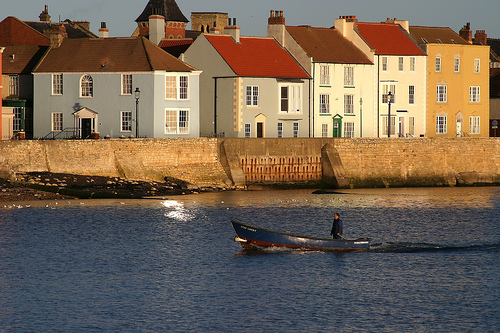

In [64]:
test_image = Captioning(0, len(path_test))
Image.open(test_image)